In [1]:
import sys,os
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt 
import seaborn as sns
from IPython.display import HTML
from IPython.display import Image
matplotlib.rc("savefig", dpi=1000)
%matplotlib inline

**Data**

In [329]:
# Pull datasets

def filter_lat_lng(d,city):
    
    if city == 'SF':
        d=d[d.X != -120.5]
        d=d[d.X < -122.37]
        d=d[d.X > -122.51]
        
    elif city == 'NY':
        
        d=d[d.Y < 40.9128687953]
        d=d[d.Y > 39.5525551789]
        d=d[d.X < -73.254532] 
        d=d[d.X > -74.254532]   
        
    return d
    
def extract_category(d,field,cat,city):
    
    ''' Extract all data of a specific category '''
    
    # Extract category
    d=pd.DataFrame(d[d[field]==cat])
    
    # Filter
    d=filter_lat_lng(d,city)
    
    return d

def plt_data(d,color,year,s,a):
    
    f1=plt.figure(figsize=(7,7),dpi=600,facecolor='black')
    ax = f1.add_subplot(1, 1, 1)
    plt.scatter(d.X,d.Y,c=color,s=size,alpha=a,edgecolor='') 
    # plt.text(0.1, 0.9,year,ha='center',va='center',color='w',transform=ax.transAxes)
    plt.axis('off')
    plt.show()

def plt_maps_ts(d,c):
     
    # Get year
    d['year']=pd.DatetimeIndex(d.Date).year
    
    # Params
    size=0.55
    a=0.075
    f1=plt.figure(figsize=(10,10),dpi=600,facecolor='black')
    
    for i,year in enumerate(sorted(d.year.unique())):
    
        yr_data = d[d.year == year]
        
        ax = f1.add_subplot(4,4, i+1)
        plt.scatter(yr_data.X,yr_data.Y,c=c,s=size,alpha=a,edgecolor='') 
        plt.text(0.1, 0.9,year,ha='center',va='center',color='w',transform=ax.transAxes)
        plt.axis('off')

def get_data(d_set_name):
    
    d=pd.read_csv(os.getcwd()+'/data/%s'%d_set_name)
    return d
    
def plt_hotspots(d,s,a,t1,t2,t3,bg):

    top_locations = d.groupby('Address').size().sort_values()
    tier1=top_locations[top_locations >= t1]
    tier2=top_locations[(top_locations < t1) & (top_locations >= t2)]
    tier3=top_locations[(top_locations < t2) & (top_locations >= t3)]
    tier4=top_locations[top_locations < t3]

    f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
    for locs,c,size in zip(reversed([tier1,tier2,tier3,tier4]),
                           reversed(['r','y','g',bg]),
                           reversed([s,s,s,s])):

        d_plt = d[d.Address.isin(list(locs.index))]
        ax = f1.add_subplot(1,1,1)
        plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
        plt.axis('off')
        
def plt_by_type(d,s,a,c1,c2,c3,c4,agg):
    
    if agg:
        
        tier1=d[d.Descriptor == c1]
        tier_else=d[d.Descriptor != c1]
        
        f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
        for d_plt,c,size in zip(reversed([tier1,tier_else]),
                               reversed(['r','g']),
                               reversed([s,s])):

            ax = f1.add_subplot(1,1,1)
            plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
            plt.axis('off')
            
     
    else:
        
        tier1=d[d.Descriptor == c1]
        tier2=d[d.Descriptor == c2]
        tier3=d[d.Descriptor == c3]
        tier4=d[d.Descriptor == c4]

        f1=plt.figure(figsize=(7.5,7.5),dpi=600,facecolor='black')
        for d_plt,c,size in zip(reversed([tier1,tier2,tier3,tier4]),
                               reversed(['r','m','y','g']),
                               reversed([s,s,s,s])):

            ax = f1.add_subplot(1,1,1)
            plt.scatter(d_plt.X,d_plt.Y,c=c,s=size,alpha=a,edgecolor='') 
            plt.axis('off')
            

#sf_crime = get_data('Map_of_Police_Department_Incidents.csv')
#ny_311 = get_data('311_Service_Requests_from_2010_to_Present.csv')
#ny_rodents = get_data('Rodent_Inspection.csv')
#ny_crashes = get_data('NYPD_Motor_Vehicle_Collisions.csv')
#sf_311 = get_data('311_Cases.csv')

**SF 311**

In [204]:
sf_311['Y']=sf_311['Latitude']
sf_311['X']=sf_311['Longitude']
sf_311['Date']=sf_311['Opened']
sf_tags = extract_category(sf_311,'Category','Graffiti','SF')

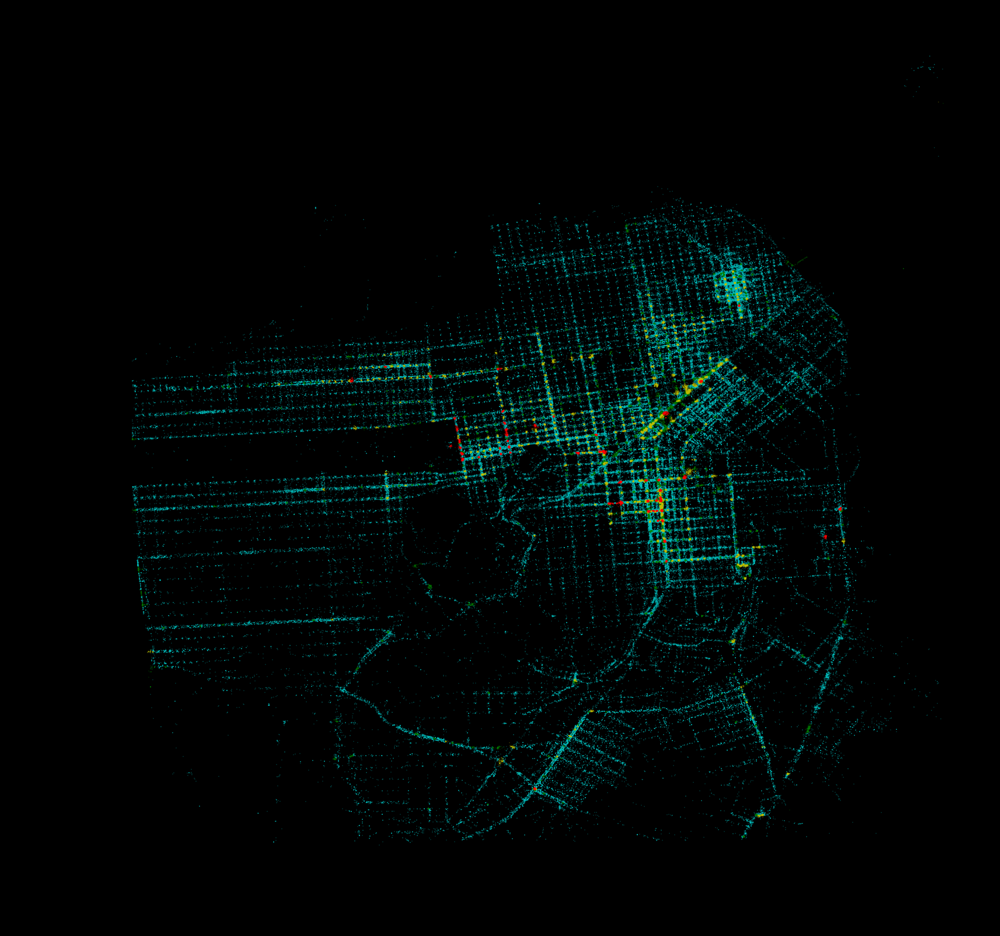

In [322]:
s=0.25
a=0.25
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(sf_tags,s,a,t1,t2,t3,'c')

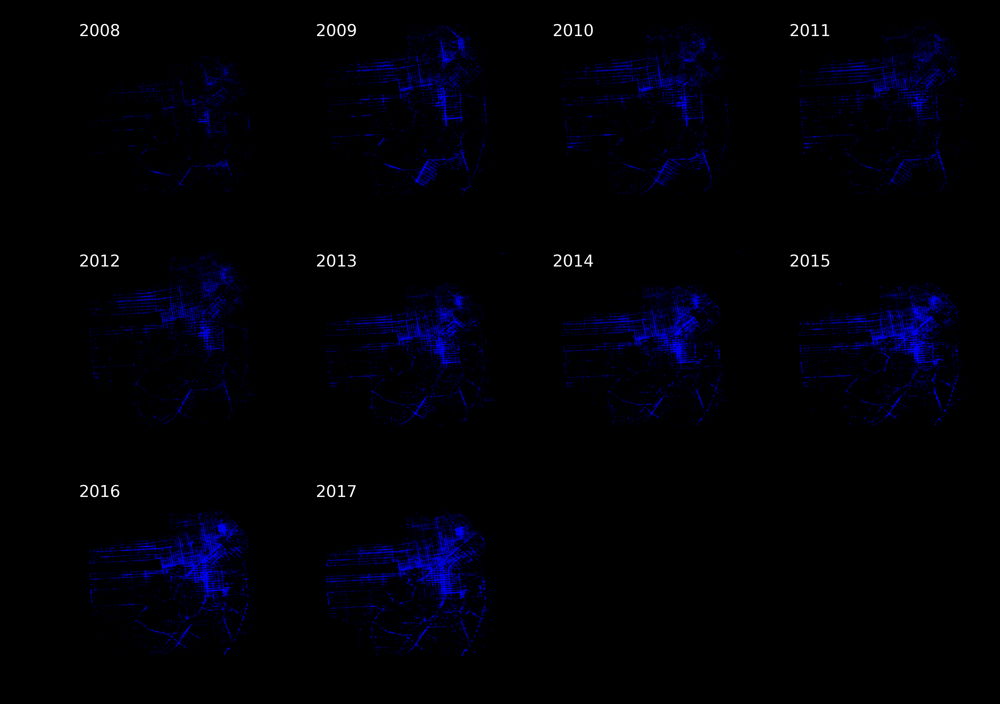

In [89]:
plt_maps_ts(sf_tags,'b')

**SF Theft**

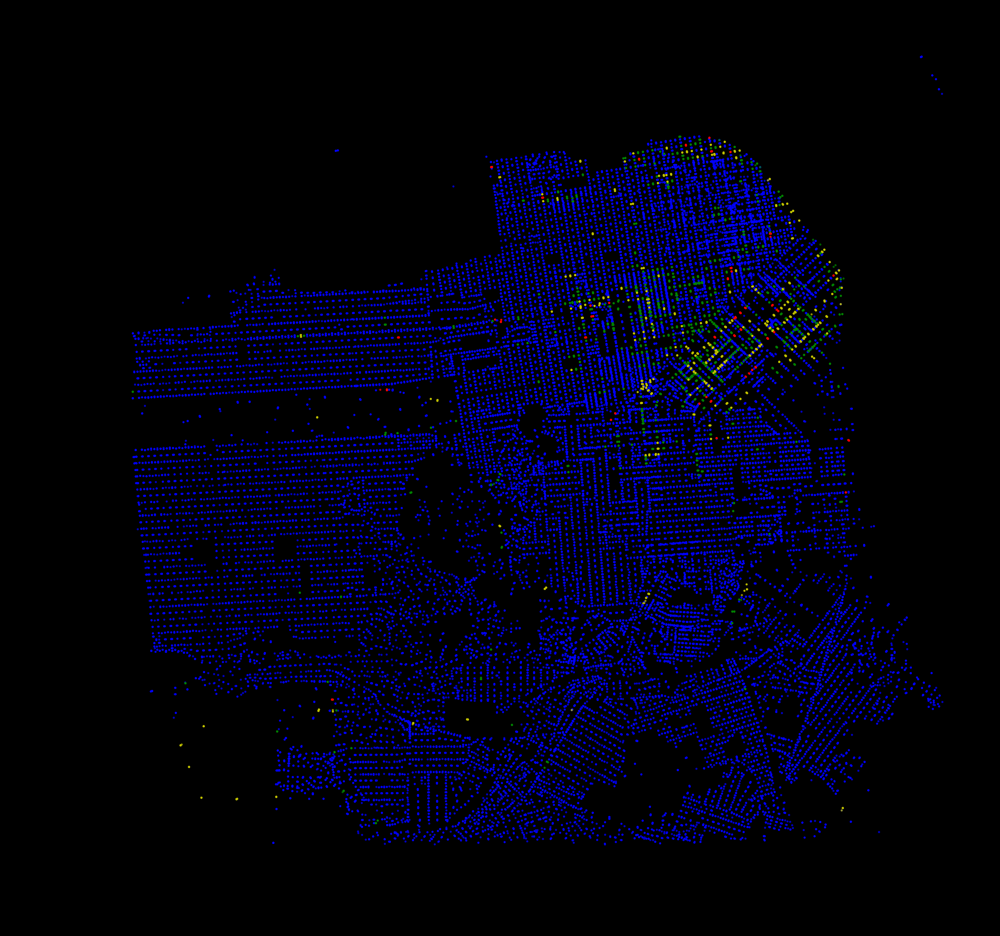

In [328]:
sf_theft = extract_category(sf_crime,'Category','LARCENY/THEFT','SF')
sf_auto_theft = pd.DataFrame(sf_theft[sf_theft.Descript.str.contains('AUTO')])

s=1.0
a=0.75
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(sf_auto_theft,s,a,t1,t2,t3,'b')

**NY Crashes**

In [183]:
ny_crashes['Y']=ny_crashes['LATITUDE']
ny_crashes['X']=ny_crashes['LONGITUDE']
ny_crashes['Date']=ny_crashes['DATE']
ny_crashes['Address']=ny_crashes['OFF STREET NAME'].astype(str)+ny_crashes['ON STREET NAME'].astype(str)
ny_crashes['Address'] = ny_crashes['LOCATION']
ny_crashes=filter_lat_lng(ny_crashes,'NY')

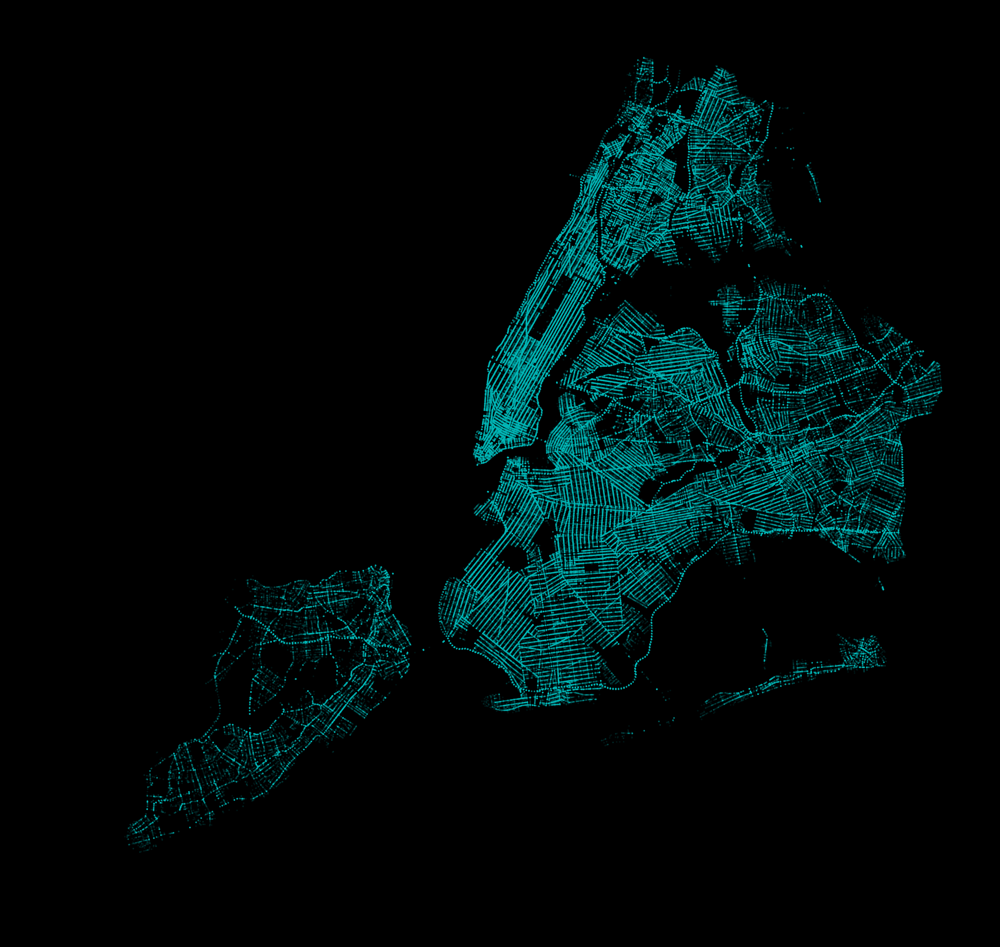

In [186]:
s=0.5
a=0.1
plt_data(ny_crashes,'c','2003-2017',s,a)

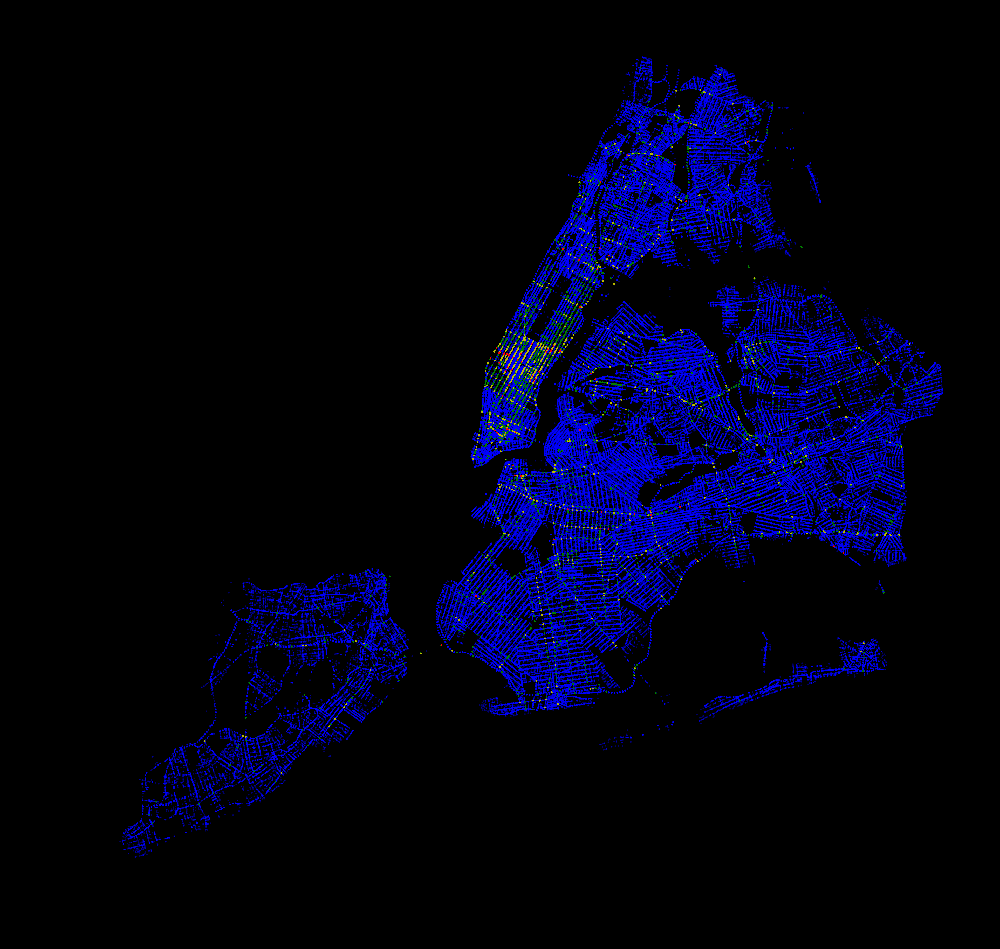

In [332]:
s=0.5
a=0.4
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(ny_crashes,s,a,t1,t2,t3,'b')

**NY Noise**

In [278]:
ny_311[ny_311['Complaint Type']=='Noise - Residential'].groupby('Descriptor').size().sort_values()

Descriptor
Loud Television      24708
Loud Talking         83151
Banging/Pounding    342181
Loud Music/Party    887224
dtype: int64

In [128]:
ny_311['Y']=ny_311['Latitude']
ny_311['X']=ny_311['Longitude']
ny_311['Address']=ny_311['Incident Address']
ny_noise = extract_category(ny_311,'Complaint Type','Noise - Residential','NY')

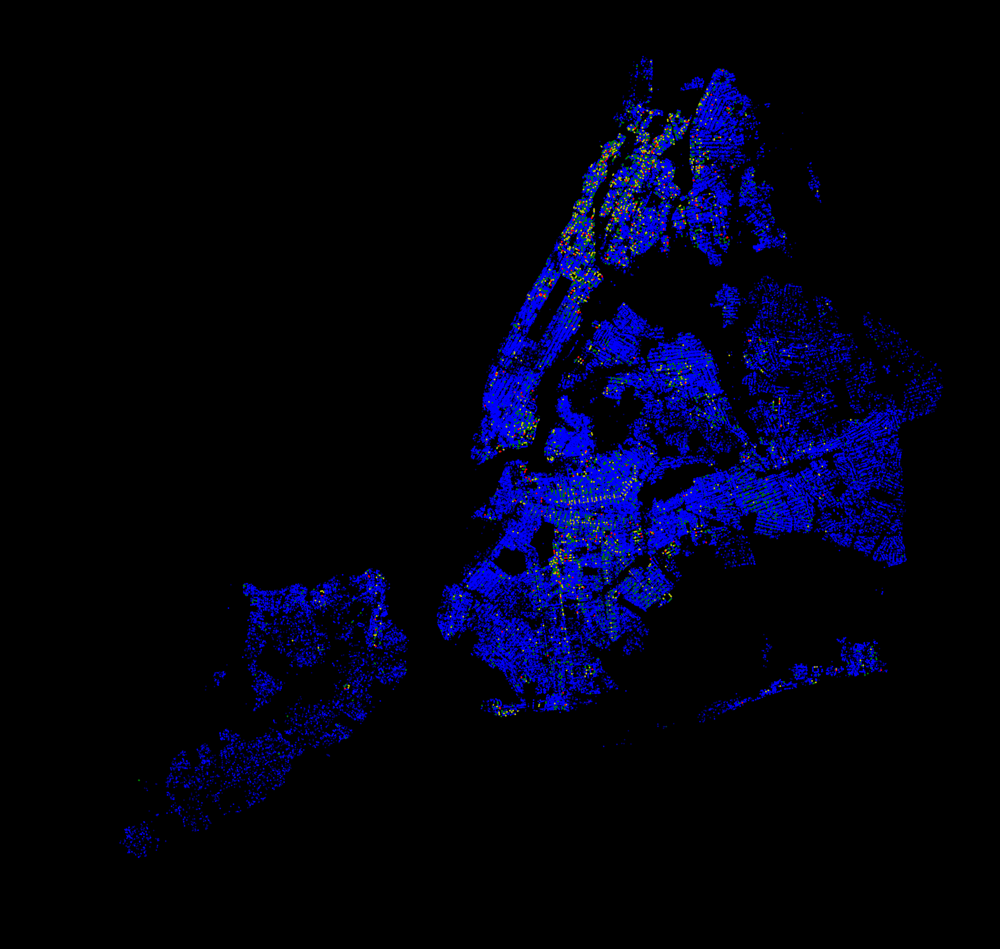

In [268]:
s=0.5
a=0.4
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(ny_noise,s,a,t1,t2,t3)

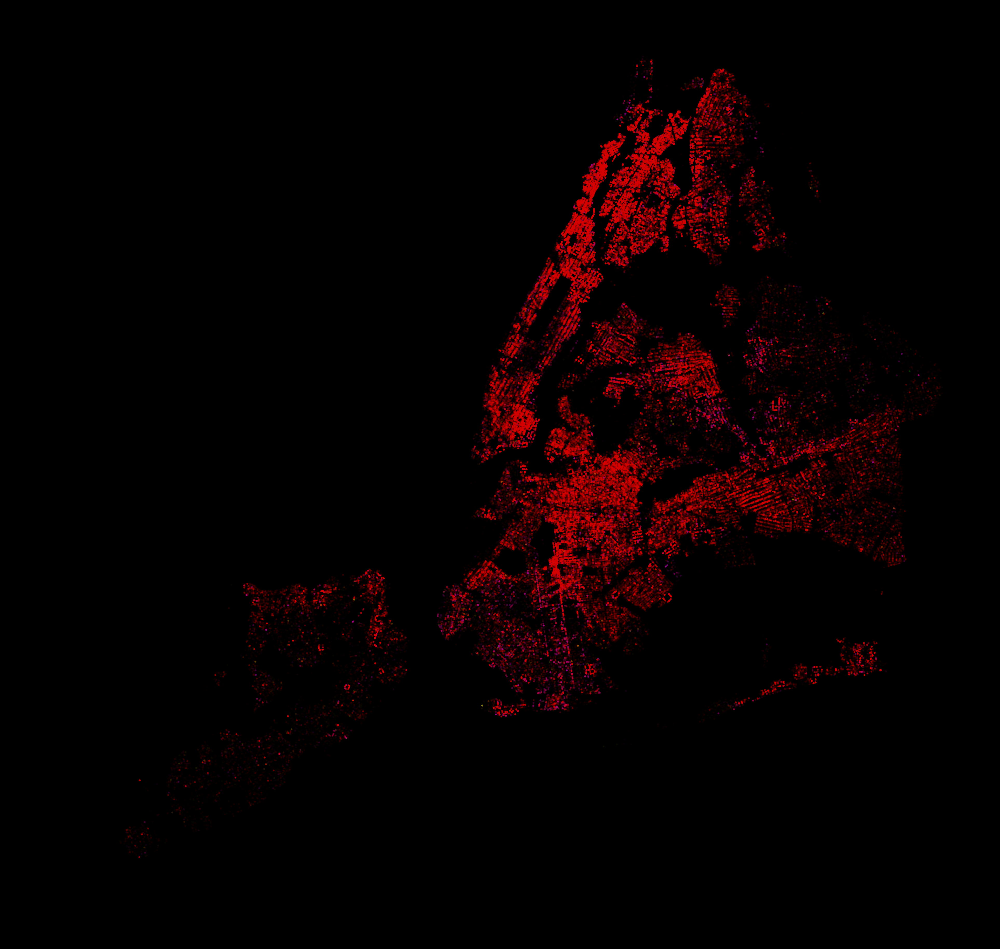

In [309]:
s=0.75
a=0.025
c4='Loud Television'
c3='Loud Talking'
c2='Banging/Pounding'
c1='Loud Music/Party'
plt_by_type(ny_noise,s,a,c1,c2,c3,c4,False)

**NY Taxi**

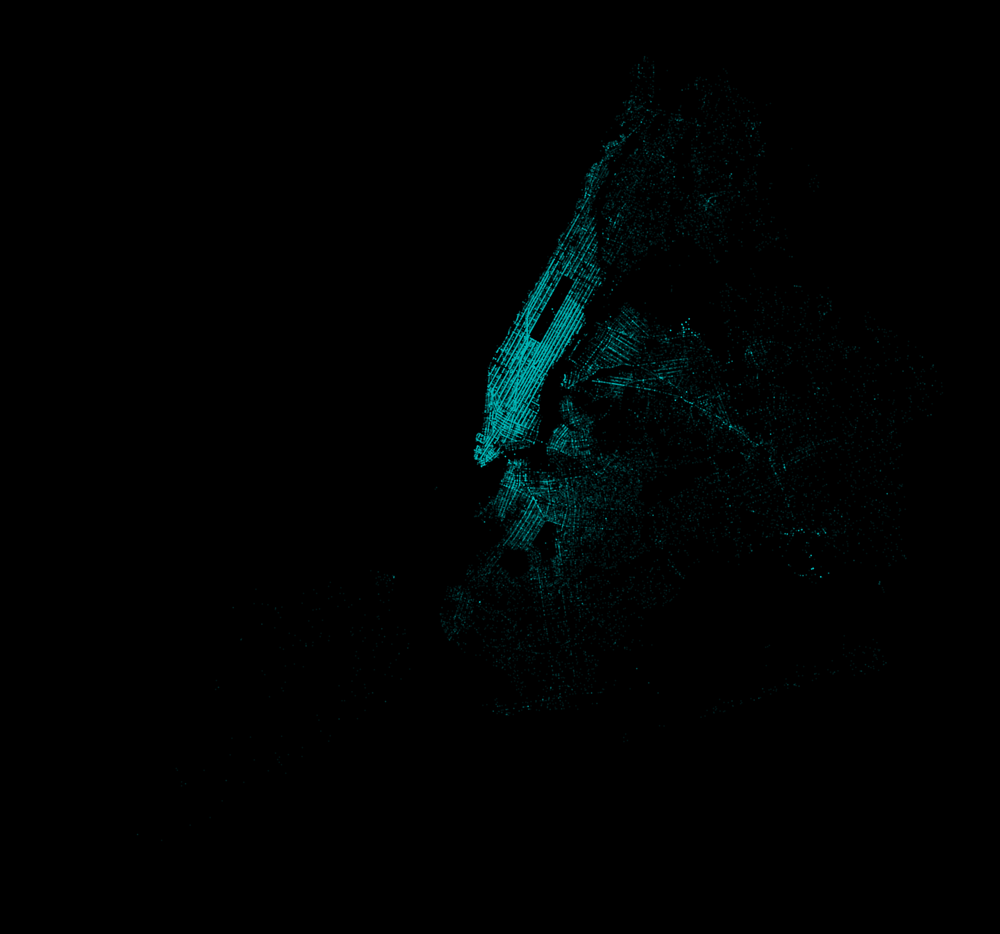

In [236]:
d = extract_category(ny_311,'Complaint Type','Taxi Complaint','NY')
plt_data(d,'c','2003-2017')

s=0.5
a=0.1
t1 = 250
t2 = 100
t3 = 50
plt_hotspots(d,s,a,t1,t2,t3)

**NY Rodents**

In [286]:
ny_rodents['Y']=ny_rodents['LATITUDE']
ny_rodents['X']=ny_rodents['LONGITUDE']
ny_rodents['Date']=ny_rodents['APPROVED_DATE']
ny_rodents['Address']=ny_rodents['HOUSE_NUMBER'].astype(str)+ny_rodents['STREET_NAME'].astype(str)
ny_rodents['Address']=ny_rodents['LOCATION']
ny_rodents['Descriptor']=ny_rodents['RESULT']
ny_rodents=filter_lat_lng(ny_rodents,'NY')

In [287]:
print ny_rodents.groupby('Descriptor').size().sort_values()

Descriptor
Cleanup done            1189
Monitoring visit       21802
Problem Conditions    144383
Active Rat Signs      158492
Bait applied          169441
Passed Inspection     804668
dtype: int64


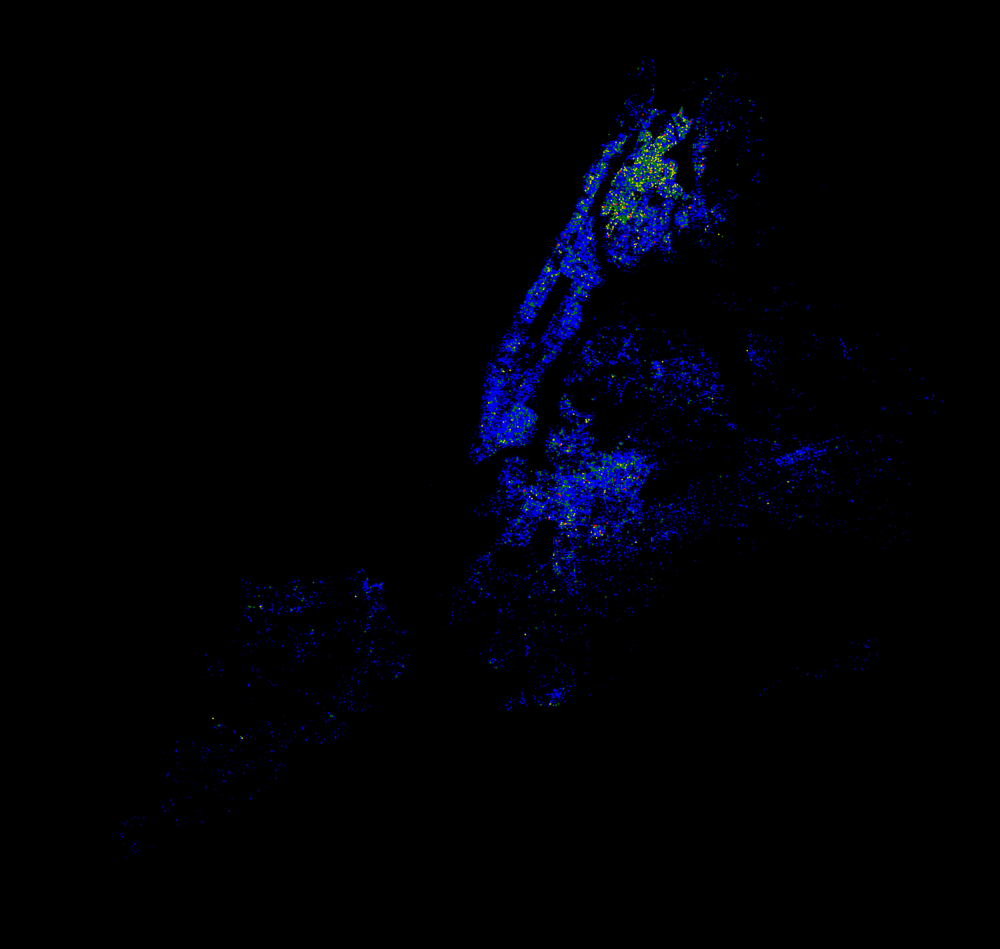

In [269]:
s=0.5
a=0.4
t1 = 15
t2 = 10
t3 = 5
# plt_data(active,'c','2003-2017',s,a)
active = ny_rodents[ny_rodents.RESULT == 'Active Rat Signs']
plt_hotspots(active,s,a,t1,t2,t3)

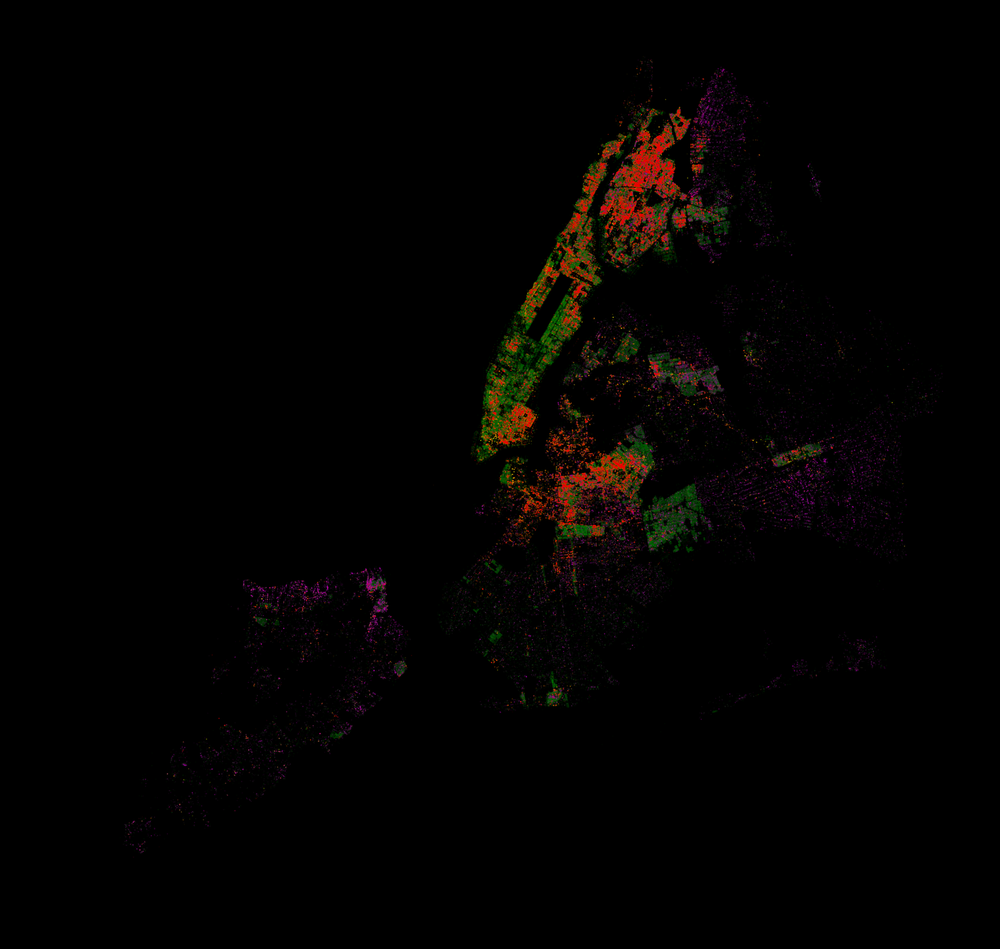

In [310]:
s=0.35
a=0.05
c4='Passed Inspection'
c3='Bait applied'
c2='Problem Conditions'
c1='Active Rat Signs'
plt_by_type(ny_rodents,s,a,c1,c2,c3,c4,False)

**Explore**

In [ ]:
''' 
top_50_cat_ny = ny_311.groupby('Complaint Type').size().sort_values().tail(50)
for i in top_50_cat_ny.index:
    print "---%s---"%i
    d_ = extract_category(ny_311,'Complaint Type',i,'NY')
    plt_data(d_,'c','2003-2017')
    plt_hotspots(d_)
    print "-------"
    print "-------"

top_10_cat_sf = sf_311.groupby('Category').size().sort_values().tail(10)
for i in top_10_cat_sf.index:
    print "---%s---"%i
    d_ = extract_category(sf_311,'Category',i,'SF')
    plt_data(d_,'c','2003-2017')
    plt_hotspots(d_)
    print "-------"
    print "-------"
'''